# Imports

In [1]:
%matplotlib inline

In [2]:
import pandas as pd
import numpy as np
import plotly.express as px
from eli5 import explain_weights

from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import OneHotEncoder, Normalizer, StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import average_precision_score
from sklearn.neighbors import KNeighborsClassifier

from imblearn.over_sampling import ADASYN, SMOTE
from imblearn.pipeline import Pipeline

In [3]:
DATA_FILE = 'data/lemonade_ds_coding_task_data_(2).csv'

# Load data

In [4]:
risk_data = pd.read_csv(DATA_FILE)

In [5]:
risk_data = risk_data.set_index('id')

# EDA

First things first. Lets take a look at the data:

In [6]:
risk_data.head()

,state,postal_code,product,user_id,square_ft,high_risk_dog,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target
id,,,,,,,,,,,,,,,
2492008697672104938,NM,87043,ho4,-9160046293075786063,NaN,0,True,True,0.0,NaN,5,0,39.0,credit,False
886075317023782670,WI,53715,ho4,-8929003830875133003,NaN,0,True,False,1.0,30.0,1,0,19.0,debit,False
5527292118261850881,WI,53211,ho4,-9015977226434470133,NaN,0,True,False,1.0,1.0,1,0,20.0,debit,True
6453397743269682220,NM,88012,ho4,-9060026899039337265,NaN,0,True,True,1.0,NaN,1,0,33.0,debit,False
-8836394806705049849,AR,72116,ho4,-8801719090048493625,NaN,0,False,False,1.0,NaN,1,0,20.0,debit,False


Now lets go over the columns that we have in our data and see what may interest us about it:

state (categorical): USA state<br>
postal_code (categorical): USA postal code for more exact location<br>
product (categorical): which product does the customer have<br>
card_type (categorical): type of payment do they use<br>
<br>
high_risk_dog (boolean): do they have a high risk dog<br>
has_fire_alarm (boolean): do they have a fire alarm<br>
has_burglar_alarm (boolean): do they have a burglery alarm<br>
<br>
id (int): id of the policy<br>
user_id (int): unique user id<br>
square_ft (int): how big is the space they are insuring<br>
portable_electronics (int): do they have portable electronics<br>
coast (int): how close do they live to the coast(if at all)<br>
fire_housing_proximity (int): how close do they live to a fire house<br>
previous_policies (int): have they had previous policies<br>
user_age (int): how old is the user<br>
<br>
target (boolean): True or False<br>
    
    
Now that we are aquanted with our columns lets ask some general questions about our data that we will have in mind as we do some freestyle EDA. <br>

1. Are there missing values? Can we fill them?<br>
2. What kind of data do you have and how do you treat different types?<br>
3. Is there data that contradicts itself? (same data, different label?)<br>
4. Where are the outliers and why should you care about them?<br>
5. How can you add, change or remove features to get more out of your data?<br>
6. What is the correlation between the features and the target.<br>


Once we have a good feel for the data we'll dive into some fixing missing values and looking for outliers.<br> 

In [7]:
risk_data.count()

state                     12397
postal_code               12397
product                   12397
user_id                   12397
square_ft                   279
high_risk_dog             12397
has_fire_alarm            12397
has_burglar_alarm         12397
portable_electronics      11990
coast                     11242
fire_housing_proximity    12397
previous_policies         12397
user_age                  12315
card_type                 12345
target                    12397
dtype: int64

### Plot feature corelation

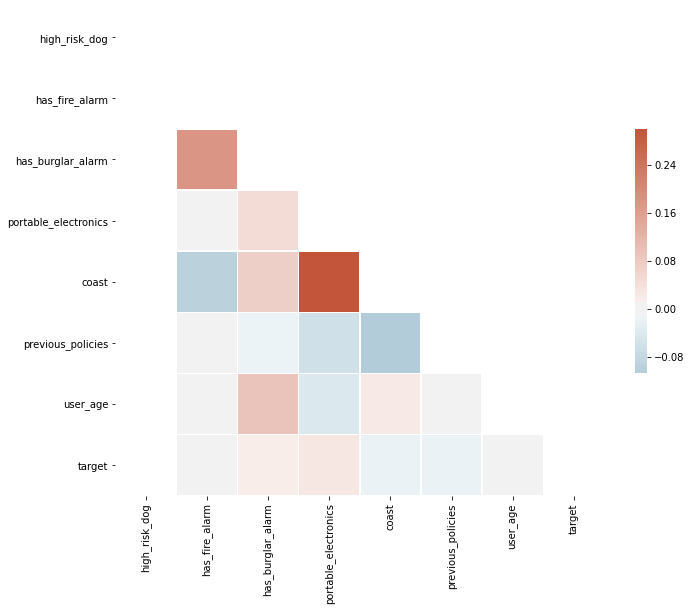

In [8]:
import seaborn as sns
import matplotlib.pyplot as plt

d = risk_data[['high_risk_dog', 'has_fire_alarm', 'has_burglar_alarm',
       'portable_electronics', 'coast', 'fire_housing_proximity',
       'previous_policies', 'user_age', 'target']]

# Compute the correlation matrix
corr = d.corr()
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

The above plot does not have that many strong correlations. Definitely no features that are repeats of each other.<br>

The main item that sticks out is that coast and portable electronics are corelated. My guess about this would be that most big cities are near the coast and people living in big cities are in a higher socio-economic class and thus more likely to have portable electronics. But that may be over simplifying it. <br>

As for our target. None of our feature are correlated particularly strongly, we will definitely need to do some strong feature engineering.<br>

I have to say this correlation matrix shocks me a bit. I was expecting more correlation between the features. Maybe we need to create more sub-groups in order for the correlations to be felt more strongly?

### High risk dog

We can see from the plot above that high risk dog seems to have no correlation with any of the features. Lets see why.

In [9]:
px.histogram(risk_data, x="high_risk_dog", width=800, height=300)

As suspected this feature is completely static. This means it does not give us any information at all and we can safely drop this feature. 

It is likely that this is a very sparse feature. In the future if we collect more data it is worth revisiting the feature to see if it becomes relevant. It could probably become relevant in the case where:<br>
1. We have several orders of magnitute more data (in which case it would be a very sparse feature but could still possibly be  helpful) <br>
2. If for some reason our current sample of people just dont happen to have high risk dogs (maybe the states we collect from dont allow them) but in the future our sample expands to include them <br>

#### Static columns check
Lets do a quick check to make sure that none of our other columns are static

In [10]:
risk_data.columns[risk_data.nunique() <= 1]

Index(['high_risk_dog'], dtype='object')

Nope just high_risk_dog. Lets go ahead and drop that column

In [11]:
risk_data = risk_data.drop(['high_risk_dog'], axis=1)

#### Unique count of columns

While we are at it lets take a look at the unique count of each column

(We could drop the booleans for this analysis but we will just ignore them)

In [12]:
risk_data.nunique()

state                        21
postal_code                2565
product                       3
user_id                   10000
square_ft                   183
has_fire_alarm                2
has_burglar_alarm             2
portable_electronics          2
coast                        11
fire_housing_proximity       15
previous_policies             8
user_age                     72
card_type                     3
target                        2
dtype: int64

This tells us a few interesting things.

1. There are only 10,000 users but there are 12,397 data points. We have some users with multiple requests. <br>
2. We have only 21 states out of 50.<br>
3. We have 3 products.<br>
4. We have a wide age spread (at least 72 years)<br>

### Age

Lets now take a look at age. I feel like age will play a big part in our final model and understanding our data.

In [13]:
risk_data['user_age'].describe()

count    12315.000000
mean        31.085668
std         10.000254
min         17.000000
25%         24.000000
50%         29.000000
75%         35.000000
max        112.000000
Name: user_age, dtype: float64

In [14]:
px.histogram(risk_data, x="user_age", color='target', marginal="box", width=1000, height=500)

So age seems to be a slight factor but not much. Depending on the model may be worth binning. For now this seems a bit of a dead end. At least from an analytical perspective. We'll come back to it when we work on feature engineering.

### Investigate missing values in square feet

We saw above that square feet only has 279 values. I would guess that this is because size only matter for homeowners insurance and not for renter insurance. Lets take a look at product types. 

In [15]:
px.histogram(risk_data, x="product", width=800, height=300)

Seems like the assumption is reasonable. ho4 seems like our renters inssurance as it is the most popular. 

Not only that but ho3 and ho6v are extremely sparse. I have a feeling they will not be very helpful for out model. Lets take a quick look at this subset of data.

(Later found out that ho4, ho3, and ho6 are industry standardized names. ho4: Renter, ho3: Homeowners, ho6:Condo)

#### Looking at ho3 and ho6

We are creating a column of the target that is of type int just so that we can use it for statistics. (Mean, std, etc. as seen below)

In [16]:
risk_data['int_target'] = risk_data['target'].astype(int)

Lets compare the distibution of the features of our three products.

In [17]:
ho6 = risk_data[(risk_data['product'] == 'ho6')]

In [18]:
ho3 = risk_data[(risk_data['product'] == 'ho3')]

In [19]:
px.box(risk_data, y="user_age", color='product', width=1000, height=500)

In [20]:
px.box(risk_data, y='coast', color='product', width=1000, height=500)

From a quick glance we can see that these are significantly different samples. ho3 and ho6 users are older on average, live  closer to the coast, have fewer portable electronics and are more likely to have had a previous policy. (only kept two of the plots consiseness)

I don't know what I am going to do with the sparse non-renters data. For now I am moving on.<br>

### Mapping the data

In [21]:
state_heat_map = risk_data.groupby('state').size().rename('count').to_frame().reset_index()

In [22]:
px.choropleth(state_heat_map, locations='state', color='count', locationmode="USA-states", scope="usa")

As we saw before we have sample from 21 states. From the above graph we can see that most of them belong to (in descending order) California, Texas, New York and Illinois. The other 17 states have very few data samples.

Lets see if we can get a better resolution than state level.

In [23]:
postal_code_heat_map = risk_data.groupby('postal_code').size().rename('count').to_frame().reset_index()

In [24]:
# data can be downloaded from: https://public.opendatasoft.com/explore/dataset/us-zip-codes/export/
zip_codes = pd.read_csv('data/us-zip-codes.csv', sep=';')
zip_codes = zip_codes[~zip_codes['Zipcode'].duplicated()]

For some reason zipcode has multiple inputs for each zipcode and it was effecting out merges. I checked them out and their longitude and latitude are identical so we can just drop the duplicates.

In [25]:
full_zip = pd.merge(postal_code_heat_map, zip_codes[['Zipcode', 'Lat', 'Long']], how='left', left_on='postal_code', right_on='Zipcode', )

In [26]:
fig = px.density_mapbox(full_zip, lat='Lat', lon='Long', z='count', radius=15, zoom=0,)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

This plot tells a very different story. The states are mainly irrelevant. What the above plot makes vastly clear to me is that the majority of the quote requests come from large cities. Such as New York, San Fransisco, Texas, etc.<br>

I imagine that there are many reasons for this:<br>
1. Large cities are densely populated<br>
2. Large cities are populated by people more likely to use more advanced technology.<br>
3. Word of mouth (or advertisements) can travel faster (and ber more effective) in big cities<br>
I'm sure there are more reasons but we get the gist.<br>

Lets take a quick look at previous_policies and card_type and then we'll move on to filling missing values and anomaly detection.

### Card Type

In [27]:
# risk_data['card_type'].value_counts()
px.histogram(risk_data, x="card_type", width=800, height=300)

Ok debit is most common with credit a close second and a small amount of prepaid. On a hunch lets take a look at the percentage of risk in each.

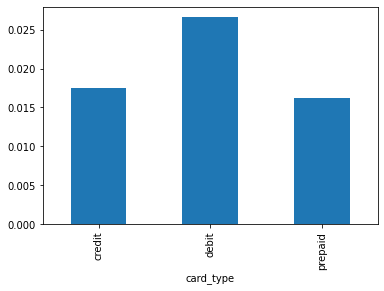

In [28]:
(risk_data.groupby(['card_type', 'target']).size() / risk_data.groupby(['card_type']).size()).unstack()[True].plot(kind='bar')

We can see that there is more risk from people who pay with debit. I would have guessed that it was prepaid but this is still interesting.

### Previous Policies

Lets take a look at how many people have had previous policies:

In [29]:
risk_data[risk_data['previous_policies'] > 0].shape

(2499, 15)

and the distribution:

In [30]:
risk_data['previous_policies'].value_counts()

0    9898
1    2152
2     275
3      48
4      19
5       3
7       1
6       1
Name: previous_policies, dtype: int64

## Missing Values

In [31]:
risk_data.head(10)

,state,postal_code,product,user_id,square_ft,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target,int_target
id,,,,,,,,,,,,,,,
2492008697672104938,NM,87043,ho4,-9160046293075786063,NaN,True,True,0.0,NaN,5,0,39.0,credit,False,0
886075317023782670,WI,53715,ho4,-8929003830875133003,NaN,True,False,1.0,30.0,1,0,19.0,debit,False,0
5527292118261850881,WI,53211,ho4,-9015977226434470133,NaN,True,False,1.0,1.0,1,0,20.0,debit,True,1
6453397743269682220,NM,88012,ho4,-9060026899039337265,NaN,True,True,1.0,NaN,1,0,33.0,debit,False,0
-8836394806705049849,AR,72116,ho4,-8801719090048493625,NaN,False,False,1.0,NaN,1,0,20.0,debit,False,0
2248669815880701912,WI,53593,ho4,-9008836729344443063,NaN,False,False,1.0,30.0,3,1,23.0,credit,False,0
294015809810067632,RI,2871,ho4,-9066886574715380573,NaN,True,False,1.0,0.0,4,0,40.0,credit,False,0
7789812989353637707,NM,87102,ho4,-9124429966396909586,NaN,True,False,1.0,NaN,1,0,58.0,debit,False,0
-8663673256371482122,RI,2908,ho4,-8959737638697722410,NaN,False,False,1.0,10.0,2,2,19.0,debit,False,0


In [32]:
risk_data.isna().sum()

state                         0
postal_code                   0
product                       0
user_id                       0
square_ft                 12118
has_fire_alarm                0
has_burglar_alarm             0
portable_electronics        407
coast                      1155
fire_housing_proximity        0
previous_policies             0
user_age                     82
card_type                    52
target                        0
int_target                    0
dtype: int64

Off the bat we already knew that square_ft was going to be an issue. I believe we will not be using this feature but for now will change the nan values to be 0 and we will work from there. I think that 0 as a value are good because the column is to sparse for average to work. As well models like logistic regression will just ignore a 0 value, while forests will not be able to seperate the values if they are all the same.

In [33]:
risk_data['square_ft'] = risk_data['square_ft'].fillna(0) 

#### Coast

Lets take a look at how the data is distributed (as we didnt really look at this data before)

In [34]:
px.histogram(risk_data, x="coast", color='target', width=800, height=300)

It seems like you can type in 30 if you are more than 30 miles from the coast. So that seems like the best "default" value to fill the missing values.

(We changed this later on to 20 to assume some risk when the value is unknown)

In [35]:
risk_data['coast'] = risk_data['coast'].fillna(30) 

#### portable_electronics       

In [36]:
px.histogram(risk_data, x="portable_electronics", width=800, height=300)

Here 0 also seems like the right way to go.

(This we also decided later on to change to 1 as we assume that is more risky [creates more exposure] and prefer to assume more risk over less)

In [37]:
risk_data['portable_electronics'] = risk_data['portable_electronics'].fillna(0) 

#### User age

Here we will use the mode age of a user as that makes the most sense. Another option is to drop the requests (rows)  with missing values but we really dont have that much data so it is much more advisable to try and salvage it.<br>
The mean and median are both effected by the liong tail so here the mode is the best estimate of user age.<br> 

In [38]:
risk_data['user_age'].mode()

0    24.0
dtype: float64

In [39]:
risk_data['user_age'] = risk_data['user_age'].fillna(risk_data['user_age'].mode()[0])  

#### card type

Here we will also use mode as it is also the most reasonable.

In [40]:
risk_data['card_type'].mode()[0]

'debit'

In [41]:
risk_data['card_type'] = risk_data['card_type'].fillna(risk_data['card_type'].mode()[0])                   

Lets just check that we dealt with everything

In [42]:
risk_data.isna().sum()

state                     0
postal_code               0
product                   0
user_id                   0
square_ft                 0
has_fire_alarm            0
has_burglar_alarm         0
portable_electronics      0
coast                     0
fire_housing_proximity    0
previous_policies         0
user_age                  0
card_type                 0
target                    0
int_target                0
dtype: int64

Ok cool. Lets try doing a slightly deeper dive into the data with a focus on generating ideas for features.

## Clustering

In [43]:
risk_data.columns

Index(['state', 'postal_code', 'product', 'user_id', 'square_ft',
       'has_fire_alarm', 'has_burglar_alarm', 'portable_electronics', 'coast',
       'fire_housing_proximity', 'previous_policies', 'user_age', 'card_type',
       'target', 'int_target'],
      dtype='object')

It was at this point that I realized that I didnt properly investigate fire housing_proximity as I thought it was an int. This was mostly correct. But partially incorrect (which is the part that mattered). Below we can see that there are values that not integers. These values are used as metrics for distance from firehouse see [here](https://www.verisk.com/insurance/visualize/new-ppc-fire-protection-classes-to-benefit-insurers-communities/).<br>

For our purpose it will be enough to map each of the inputs to an integer:

There is probably a more clever way to extract the number but for our purposes this will work. For the long term and for data extraction in real time if we expect the data to sometimes come in non integer format we will create something more robust.

In [44]:
risk_data['fire_housing_proximity'].value_counts()

1     6391
2     3574
3     1616
4      595
5      171
6       27
7        6
5X       3
7X       3
8B       3
8        2
5Y       2
4Y       2
4X       1
6Y       1
Name: fire_housing_proximity, dtype: int64

In [45]:
risk_data['fire_housing_proximity'] = risk_data['fire_housing_proximity'].map({'5X':5, '8B':8, '7X':7, '4Y':4, '5Y':5, '4X':4, '6Y':6, '1':1, '2':2, '3':3, '4':4, '5':5, '6':6, '7':7, '8':8})

In [46]:
risk_data['fire_housing_proximity'].value_counts(dropna=False)

1    6391
2    3574
3    1616
4     598
5     176
6      28
7       9
8       5
Name: fire_housing_proximity, dtype: int64

In [47]:
from sklearn.manifold import TSNE
tsne = TSNE(n_jobs=-1)

In [48]:
tsne_data = tsne.fit_transform(risk_data[['has_fire_alarm', 'has_burglar_alarm', 'coast',
       'portable_electronics', 'fire_housing_proximity', 'user_age',
       'previous_policies']].astype(int))

In [49]:
tsne_df = pd.DataFrame(data=tsne_data, index=risk_data.index, columns=['tsne_x', 'tsne_y'])

In [50]:
tsne_df = pd.merge(tsne_df, risk_data, how='left', left_index=True, right_index=True)

In [51]:
px.scatter(tsne_df, x='tsne_x', y='tsne_y', color='target', hover_data=['has_fire_alarm', 'has_burglar_alarm', 'coast',
       'portable_electronics', 'fire_housing_proximity', 'user_age', 'previous_policies'])

Not that this is suprising but tsne has not found any specific group without risk. We can see that while tse tried to group "like with like", the risk is still spread out quite evenly over the whole graph. <br>

So lets try more targeted searches to see what we can find.

### Target EDA

We are now going to take a more targeted look at our target to see if we can get a feel for how it behaves

#### Mapping target

In [52]:
zip_codes

,Zipcode,ZipCodeType,City,State,LocationType,Lat,Long,Xaxis,Yaxis,Zaxis,WorldRegion,Country,LocationText,Location,Decommisioned,TaxReturnsFiled,EstimatedPopulation,TotalWages,Notes,Coordinates
0,602,STANDARD,AGUADA,PR,PRIMARY,18.38,-67.18,0.36,-0.87,0.31,NaN,US,"Aguada, PR",NA-US-PR-AGUADA,False,NaN,NaN,NaN,NaN,"18.38,-67.18"
2,603,STANDARD,URB GARCIA,PR,NOT ACCEPTABLE,18.43,-67.15,0.36,-0.87,0.31,NaN,US,"Urb Garcia, PR",NA-US-PR-URB GARCIA,False,NaN,NaN,NaN,NaN,"18.43,-67.15"
4,703,STANDARD,MANS DE AGUAS BUENAS,PR,NOT ACCEPTABLE,18.25,-66.10,0.38,-0.86,0.31,NaN,US,"Mans De Aguas Buenas, PR",NA-US-PR-MANS DE AGUAS BUENAS,False,NaN,NaN,NaN,NaN,"18.25,-66.1"
5,7675,STANDARD,WESTWOOD,NJ,PRIMARY,40.98,-74.03,0.20,-0.72,0.65,NaN,US,"Westwood, NJ",NA-US-NJ-WESTWOOD,False,13245.0,24083.0,1.089095e+09,NaN,"40.98,-74.03"
6,10474,STANDARD,BRONX,NY,PRIMARY,40.84,-73.87,0.21,-0.72,0.65,NaN,US,"Bronx, NY",NA-US-NY-BRONX,False,4369.0,7377.0,9.757825e+07,NaN,"40.84,-73.87"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81796,10015,STANDARD,NEW YORK,NY,PRIMARY,40.71,-74.00,0.20,-0.72,0.65,NaN,US,"New York, NY",NA-US-NY-NEW YORK,True,NaN,NaN,NaN,Converted Decommisioned Zipcodes,"40.71,-74.0"
81808,41313,PO BOX,BETHANY,KY,PRIMARY,37.74,-83.50,0.08,-0.78,0.61,NaN,US,"Bethany, KY",NA-US-KY-BETHANY,True,NaN,NaN,NaN,Converted Decommisioned Zipcodes,"37.74,-83.5"
81815,75334,PO BOX,DALLAS,TX,PRIMARY,32.67,-96.61,-0.09,-0.83,0.53,NaN,US,"Dallas, TX",NA-US-TX-DALLAS,True,NaN,NaN,NaN,Converted Decommisioned Zipcodes; Historical ...,"32.67,-96.61"
81824,77296,PO BOX,HOUSTON,TX,PRIMARY,29.76,-95.36,-0.08,-0.86,0.49,NaN,US,"Houston, TX",NA-US-TX-HOUSTON,True,NaN,NaN,NaN,Converted Decommisioned Zipcodes; Historical ...,"29.76,-95.36"


In [53]:
target_mapping = pd.merge(risk_data, zip_codes[['Zipcode', 'Lat', 'Long']], how='left', left_on='postal_code', right_on='Zipcode', )

In [54]:
target_mapping[target_mapping['target']==1]

,state,postal_code,product,user_id,square_ft,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target,int_target,Zipcode,Lat,Long
2,WI,53211,ho4,-9015977226434470133,0.0,True,False,1.0,1.0,1,0,20.0,debit,True,1,53211,43.06,-87.96
131,WI,53207,ho4,-8946078168030400685,0.0,True,True,1.0,3.0,1,0,29.0,debit,True,1,53207,43.06,-87.96
197,AZ,85719,ho4,-9004201254195880472,0.0,False,False,1.0,30.0,1,0,21.0,debit,True,1,85719,32.24,-110.95
237,AZ,85257,ho4,-9120185389895150451,0.0,False,False,1.0,30.0,2,0,27.0,debit,True,1,85257,33.46,-111.92
345,CA,90012,ho4,-8977716988149243465,0.0,True,False,0.0,15.0,1,0,35.0,credit,True,1,90012,34.06,-118.24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12094,TX,75243,ho4,-9147849492737631948,0.0,True,False,1.0,30.0,2,0,48.0,debit,True,1,75243,32.79,-96.76
12188,TX,78757,ho4,-8861422530325992200,0.0,True,False,0.0,30.0,1,0,33.0,credit,True,1,78757,30.26,-97.74
12190,TX,77065,ho4,-8977677717355167404,0.0,False,False,1.0,30.0,3,0,32.0,debit,True,1,77065,29.76,-95.38
12237,TX,77054,ho4,-9112385078793141113,0.0,True,False,1.0,25.0,1,0,41.0,debit,True,1,77054,29.76,-95.38


In [55]:
px.scatter_geo(target_mapping, lat='Lat', lon='Long', color='target', scope='usa',)

This is the first graph to give me real hope. To me it seems that there is a real correlation to being central in a city and to being a risk. Obviously this is not a given but from this plot it seems clear that the closer to you are to the center of a city the more likely you are to be a risk. I am not sure how to create a distance to nearest city center feature. But we could possibly measure the cluster density of the area from the test set (to avoid data leakage) and base the feature on that. We could also use the amount of people in the postal code (which may be easier but less accurate). We'll see, but this is definitely a promising start.  

#### Lets go deeper 

I have found a dataset that has the major cities of the USA. Lets take a look and see if we cant get a map of all major US cities and maybe use that. Dataset can be found [here](https://hub.arcgis.com/datasets/esri::usa-major-cities/geoservice?geometry=-138.265%2C25.590%2C-54.637%2C38.572)

In [56]:
us_cities = pd.read_csv('data/USA_major_cities.csv')

In [57]:
us_cities.head(10)

,X,Y,FID,NAME,CLASS,ST,STFIPS,PLACEFIPS,CAPITAL,POP_CLASS,...,MARHH_CHD,MARHH_NO_C,MHH_CHILD,FHH_CHILD,FAMILIES,AVE_FAM_SZ,HSE_UNITS,VACANT,OWNER_OCC,RENTER_OCC
0,-111.954103,43.475792,1,Ammon,city,ID,16,1601990,,6,...,1618,1131,106,335,3352,3.61,4747,271,3205,1271
1,-112.345567,43.193937,2,Blackfoot,city,ID,16,1607840,,6,...,1091,1081,174,381,2958,3.31,4547,318,2788,1441
2,-116.230110,43.599015,3,Boise City,city,ID,16,1608830,State,8,...,16708,21233,2414,5919,50647,2.97,92700,6996,52345,33359
3,-113.793293,42.536741,4,Burley,city,ID,16,1611260,,6,...,950,861,139,358,2499,3.37,3885,241,2183,1461
4,-116.685619,43.661626,5,Caldwell,city,ID,16,1612250,,7,...,4407,3113,686,1755,10776,3.51,16323,1428,9699,5196
5,-112.469558,42.922746,6,Chubbuck,city,ID,16,1614680,,6,...,1558,1281,172,370,3586,3.40,4961,229,3324,1408
6,-116.793150,47.704589,7,Coeur d'Alene,city,ID,16,1616750,,7,...,3244,4517,638,1524,10813,2.92,20219,1824,10365,8030
7,-116.350884,43.694688,8,Eagle,city,ID,16,1623410,,6,...,2349,2450,165,398,5585,3.20,7570,501,5770,1299
8,-116.293402,43.664701,9,Garden City,city,ID,16,1629620,,6,...,673,1390,140,372,2849,2.81,5429,551,3042,1836
9,-116.801122,47.768560,10,Hayden,city,ID,16,1636370,,6,...,1257,1641,165,315,3645,3.01,5563,351,3839,1373


Lets see what values we have in class

In [58]:
us_cities['CLASS'].value_counts()

city                            2559
Census Designated Place          898
village                          192
town                             129
borough                           96
city (consolidated, balance)       4
municipality                       4
unknown                            2
city and county                    1
city and borough                   1
Name: CLASS, dtype: int64

In [59]:
us_cities.columns

Index(['X', 'Y', 'FID', 'NAME', 'CLASS', 'ST', 'STFIPS', 'PLACEFIPS',
       'CAPITAL', 'POP_CLASS', 'POPULATION', 'POP2010', 'WHITE', 'BLACK',
       'AMERI_ES', 'ASIAN', 'HAWN_PI', 'HISPANIC', 'OTHER', 'MULT_RACE',
       'MALES', 'FEMALES', 'AGE_UNDER5', 'AGE_5_9', 'AGE_10_14', 'AGE_15_19',
       'AGE_20_24', 'AGE_25_34', 'AGE_35_44', 'AGE_45_54', 'AGE_55_64',
       'AGE_65_74', 'AGE_75_84', 'AGE_85_UP', 'MED_AGE', 'MED_AGE_M',
       'MED_AGE_F', 'HOUSEHOLDS', 'AVE_HH_SZ', 'HSEHLD_1_M', 'HSEHLD_1_F',
       'MARHH_CHD', 'MARHH_NO_C', 'MHH_CHILD', 'FHH_CHILD', 'FAMILIES',
       'AVE_FAM_SZ', 'HSE_UNITS', 'VACANT', 'OWNER_OCC', 'RENTER_OCC'],
      dtype='object')

This is a lot of data that we could possibly use for features. I do worry that a lot of this data would create a bias as most of it is about the person and not about possible risks the person undertakes. So at least for now I will not use any of these extra fields. See blog post on it [here](https://www.lemonade.com/blog/ai-can-vanquish-bias/)

In [60]:
us_cities[(us_cities['POPULATION'] > 200000) & (us_cities['ST'].isin(list(risk_data['state'].unique()))) & (us_cities['CLASS'] == 'city')]

,X,Y,FID,NAME,CLASS,ST,STFIPS,PLACEFIPS,CAPITAL,POP_CLASS,...,MARHH_CHD,MARHH_NO_C,MHH_CHILD,FHH_CHILD,FAMILIES,AVE_FAM_SZ,HSE_UNITS,VACANT,OWNER_OCC,RENTER_OCC
28,-88.306742,41.759164,29,Aurora,city,IL,17,1703012,,8,...,21319,12793,2317,6141,46404,3.63,67273,4709,43541,19023
62,-87.647146,41.756488,63,Chicago,city,IL,17,1714000,,10,...,165868,168435,28332,116555,576793,3.40,1194337,148777,469562,575998
264,-85.143621,41.088504,265,Fort Wayne,city,IN,18,1825000,,8,...,19256,23716,3113,10853,63001,3.09,113541,11956,64291,37294
279,-86.146341,39.777099,280,Indianapolis,city,IN,18,1836003,State,9,...,54111,67154,11081,40153,196976,3.08,379856,47657,185487,146712
336,-93.615751,41.588569,337,Des Moines,city,IA,19,1921000,State,8,...,14516,17098,2742,8102,47491,3.11,88729,7360,51079,30290
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3645,-96.953634,32.811719,3646,Irving,city,TX,48,4837000,,8,...,19619,15971,2772,7955,51594,3.31,91128,8590,31704,50834
3661,-99.488055,27.547280,3662,Laredo,city,TX,48,4841464,,8,...,24480,11561,2301,9565,53277,4.04,68610,5065,40489,23056
3671,-101.843750,33.584393,3672,Lubbock,city,TX,48,4845000,,8,...,16410,19757,2526,8622,53042,3.09,95926,7420,48301,40205
3704,-96.695386,33.019418,3705,Plano,city,TX,48,4858016,,8,...,28788,27404,2056,6506,69464,3.15,103672,4541,62496,36635


I playerd around with the population class until I saw the amount of cities decrease drastically and when looking at the cities recognized the names as the "BIG" cities of the US. 

Lets plot these cities below and  look at it side by side with our data

In [61]:
fig = px.scatter_geo(target_mapping, lat='Lat', lon='Long', color='target',  width=800, height=500,  scope='usa',)
fig.show()


fig = px.scatter_geo(us_cities[(us_cities['POPULATION'] > 200000) & (us_cities['ST'].isin(list(risk_data['state'].unique())) & (us_cities['CLASS'] == 'city'))], lat='Y', lon='X',  scope='usa', width=800, height=500)
fig.show()

This looks very promising. We will get back to it. 

In [62]:
risk_data.columns

Index(['state', 'postal_code', 'product', 'user_id', 'square_ft',
       'has_fire_alarm', 'has_burglar_alarm', 'portable_electronics', 'coast',
       'fire_housing_proximity', 'previous_policies', 'user_age', 'card_type',
       'target', 'int_target'],
      dtype='object')

#### multi policy/request users

In [63]:
risk_data.head()

,state,postal_code,product,user_id,square_ft,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target,int_target
id,,,,,,,,,,,,,,,
2492008697672104938,NM,87043,ho4,-9160046293075786063,0.0,True,True,0.0,30.0,5,0,39.0,credit,False,0
886075317023782670,WI,53715,ho4,-8929003830875133003,0.0,True,False,1.0,30.0,1,0,19.0,debit,False,0
5527292118261850881,WI,53211,ho4,-9015977226434470133,0.0,True,False,1.0,1.0,1,0,20.0,debit,True,1
6453397743269682220,NM,88012,ho4,-9060026899039337265,0.0,True,True,1.0,30.0,1,0,33.0,debit,False,0
-8836394806705049849,AR,72116,ho4,-8801719090048493625,0.0,False,False,1.0,30.0,1,0,20.0,debit,False,0


In [64]:
risk_data.shape

(12397, 15)

In [65]:
risk_data = pd.merge(risk_data.reset_index(), zip_codes[['Zipcode', 'Lat', 'Long']], how='left', left_on='postal_code', right_on='Zipcode', )

In [66]:
risk_data = risk_data.set_index('id')

In [67]:
risk_data[(risk_data['previous_policies'] > 0)] 

,state,postal_code,product,user_id,square_ft,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target,int_target,Zipcode,Lat,Long
id,,,,,,,,,,,,,,,,,,
2248669815880701912,WI,53593,ho4,-9008836729344443063,0.0,False,False,1.0,30.0,3,1,23.0,credit,False,0,53593,42.98,-89.53
-8663673256371482122,RI,2908,ho4,-8959737638697722410,0.0,False,False,1.0,10.0,2,2,19.0,debit,False,0,2908,41.82,-71.41
-4603949136447710688,IA,52233,ho4,-8938775516579191909,0.0,True,False,0.0,30.0,3,2,21.0,credit,False,0,52233,42.04,-91.68
7013205665738751347,NM,87102,ho4,-9124429966396909586,0.0,True,False,1.0,30.0,1,1,58.0,debit,False,0,87102,35.11,-106.62
-1171512490888154870,NM,87106,ho4,-8866032195635784312,0.0,False,False,1.0,30.0,1,1,23.0,debit,False,0,87106,35.11,-106.62
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
-7639114069437612800,TX,78729,ho4,-9221855899243050552,0.0,True,False,1.0,30.0,1,1,28.0,debit,False,0,78729,30.26,-97.74
7116066326762152580,TX,75287,ho4,-8989185453936040168,0.0,False,False,1.0,30.0,2,2,24.0,debit,False,0,75287,32.79,-96.76
6254999223011440165,TX,78741,ho4,-8812150074377228568,0.0,True,False,1.0,30.0,1,1,24.0,debit,False,0,78741,30.26,-97.74


I am curios if there is any specific area which has more repeat users. Doesnt seem that there is. (As seen below)

In [68]:
px.scatter_geo(risk_data[(risk_data['previous_policies'] > 1)] , lat='Lat', lon='Long', color='previous_policies',  scope='usa', width=800, height=300)

Not that interesting

### Lets create some geographic features.

We saw above rthat is looks like there is a correlation to being close to a city and being risky. Lets try to work on the feature which is our distance from the nearest city.

In [69]:
risk_data.head()

,state,postal_code,product,user_id,square_ft,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target,int_target,Zipcode,Lat,Long
id,,,,,,,,,,,,,,,,,,
2492008697672104938,NM,87043,ho4,-9160046293075786063,0.0,True,True,0.0,30.0,5,0,39.0,credit,False,0,87043,35.32,-106.46
886075317023782670,WI,53715,ho4,-8929003830875133003,0.0,True,False,1.0,30.0,1,0,19.0,debit,False,0,53715,43.07,-89.38
5527292118261850881,WI,53211,ho4,-9015977226434470133,0.0,True,False,1.0,1.0,1,0,20.0,debit,True,1,53211,43.06,-87.96
6453397743269682220,NM,88012,ho4,-9060026899039337265,0.0,True,True,1.0,30.0,1,0,33.0,debit,False,0,88012,32.33,-106.75
-8836394806705049849,AR,72116,ho4,-8801719090048493625,0.0,False,False,1.0,30.0,1,0,20.0,debit,False,0,72116,34.78,-92.25


In [70]:
big_us_cities = us_cities[(us_cities['POPULATION'] > 200000) & (us_cities['ST'].isin(list(risk_data['state'].unique())) & (us_cities['CLASS'] == 'city'))]

In [71]:
big_us_cities.head()

,X,Y,FID,NAME,CLASS,ST,STFIPS,PLACEFIPS,CAPITAL,POP_CLASS,...,MARHH_CHD,MARHH_NO_C,MHH_CHILD,FHH_CHILD,FAMILIES,AVE_FAM_SZ,HSE_UNITS,VACANT,OWNER_OCC,RENTER_OCC
28,-88.306742,41.759164,29,Aurora,city,IL,17,1703012,,8,...,21319,12793,2317,6141,46404,3.63,67273,4709,43541,19023
62,-87.647146,41.756488,63,Chicago,city,IL,17,1714000,,10,...,165868,168435,28332,116555,576793,3.40,1194337,148777,469562,575998
264,-85.143621,41.088504,265,Fort Wayne,city,IN,18,1825000,,8,...,19256,23716,3113,10853,63001,3.09,113541,11956,64291,37294
279,-86.146341,39.777099,280,Indianapolis,city,IN,18,1836003,State,9,...,54111,67154,11081,40153,196976,3.08,379856,47657,185487,146712
336,-93.615751,41.588569,337,Des Moines,city,IA,19,1921000,State,8,...,14516,17098,2742,8102,47491,3.11,88729,7360,51079,30290


In [72]:
risk_data.head()

,state,postal_code,product,user_id,square_ft,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target,int_target,Zipcode,Lat,Long
id,,,,,,,,,,,,,,,,,,
2492008697672104938,NM,87043,ho4,-9160046293075786063,0.0,True,True,0.0,30.0,5,0,39.0,credit,False,0,87043,35.32,-106.46
886075317023782670,WI,53715,ho4,-8929003830875133003,0.0,True,False,1.0,30.0,1,0,19.0,debit,False,0,53715,43.07,-89.38
5527292118261850881,WI,53211,ho4,-9015977226434470133,0.0,True,False,1.0,1.0,1,0,20.0,debit,True,1,53211,43.06,-87.96
6453397743269682220,NM,88012,ho4,-9060026899039337265,0.0,True,True,1.0,30.0,1,0,33.0,debit,False,0,88012,32.33,-106.75
-8836394806705049849,AR,72116,ho4,-8801719090048493625,0.0,False,False,1.0,30.0,1,0,20.0,debit,False,0,72116,34.78,-92.25


In [73]:
from geopy.distance import distance
def closest(v):
    point = min(BIG_CITIES_LOCATIONS, key=lambda p: distance([v['lat'],v['lon']], [p['lat'],p['lon']]))
    return distance([v['lat'],v['lon']], [point['lat'],point['lon']])

BIG_CITIES_LOCATIONS = big_us_cities[['X', 'Y']].rename({'Y':'lat', 'X':'lon'}, axis=1).to_dict(orient='records')

In [74]:
risk_data =  risk_data.rename({'Lat':'lat', 'Long':'lon'}, axis=1)

In [75]:
for idx, row in risk_data.iterrows():
    print(closest(row))
    break

30.50133931183794 km


In [76]:
risk_data['nearest_city_center'] = risk_data.apply(closest, axis=1)

In [77]:
risk_data['nearest_city_center'] = risk_data['nearest_city_center'].astype(str).apply(lambda x: x[0:-3]).astype(float)

In [78]:
px.violin(risk_data, y="nearest_city_center", color='target', width=1000, height=500)

That doesnt look as great as I'd hoped. But the risky data points are definitely closer on average (The benign data has a much larger tail as well as slightly higher mean). Hopefully this will play in and help other features in the model as well.

In [79]:
risk_data.head()

,state,postal_code,product,user_id,square_ft,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target,int_target,Zipcode,lat,lon,nearest_city_center
id,,,,,,,,,,,,,,,,,,,
2492008697672104938,NM,87043,ho4,-9160046293075786063,0.0,True,True,0.0,30.0,5,0,39.0,credit,False,0,87043,35.32,-106.46,30.501339
886075317023782670,WI,53715,ho4,-8929003830875133003,0.0,True,False,1.0,30.0,1,0,19.0,debit,False,0,53715,43.07,-89.38,1.593389
5527292118261850881,WI,53211,ho4,-9015977226434470133,0.0,True,False,1.0,1.0,1,0,20.0,debit,True,1,53211,43.06,-87.96,4.840601
6453397743269682220,NM,88012,ho4,-9060026899039337265,0.0,True,True,1.0,30.0,1,0,33.0,debit,False,0,88012,32.33,-106.75,68.153047
-8836394806705049849,AR,72116,ho4,-8801719090048493625,0.0,False,False,1.0,30.0,1,0,20.0,debit,False,0,72116,34.78,-92.25,4.208959


__Note to the casual reader: Here is where I went wrong. Up until now I was exploring the data. But from here on out my approach was inccorrect. This was because of my deep misunderstanding of the underlying problem we are solving (before Lior answered my questions). I fixed this in the next notebook so feel free to skip to there. But I left this here (in the spirit of transparency) as it was my original train of though.__ 


# Lets build a baseline model

We have looked at the data and gotten a good feel for it. We have also created a new feature. Before we get too deep into this lets create a baseline model to see how well we can do without any additions and work from there.<br>

Before we go any further we have a lot of decisions to make about model evaluation: <br>
1. How do we want to split the data? (Do we care about user overlap? What about users that already have a policy? We want to be able to predict new users acurately)<br>
2. How do we want to evaluate the data? (Do we want to seperate a state for evaluation? This gives us an idea of how well we can do when just starting out in a new state.)<br>
3. What metrics do we want to look at? <br>


For now the answers I have are as follows:<br>
1. We will want to split in a way that if a user has multiple inputs they are either fully in test or fully in train but not split.
2. We do want to put aside a state (that we will not train on) for evaluation.
3. Being as this is extremely imbalanced data we definitely dont want accuracy. We will start by looking at distibution of probabilities as well as Precision/Recall. 


In order to prepare our model lets first transform out data to a good format.

Here we will use one hot encoding as the two columns we have have no heiarchical order and only have 3 categories each which will not create a large jump in dimensionality.

In [80]:
def cv_model(clf, X_y):
    # CV split
    group_split = StratifiedShuffleSplit(n_splits=5, test_size=.2)
    groups = X_y['user_id']
    X_y = X_y.drop('user_id', axis=1)
    # One hot encodeing for categorical features
    ohe = OneHotEncoder(handle_unknown='ignore')
    ohe_data = ohe.fit_transform(X_y[['card_type', 'product']]).todense()
    X_y = pd.merge(X_y.drop(['card_type', 'product'], axis=1), pd.DataFrame(data=ohe_data, index=X_y.index, columns=ohe.get_feature_names()), left_index=True, right_index=True)
    # change all features to flaot
    X_y = X_y.astype(float)
    #generic fillna
    X_y = X_y.fillna(0)
    # Set X and y
    X = X_y.drop('target', axis=1)
    y = X_y['target']
    print(X.shape, y.shape)

    train_model(clf, X, y, group_split, groups.values)
    
    return ohe

#### X y

In [81]:
def train_model(clf, X, y, group_split, groups):

    preds = []
    y_true = []
    preds_train = []
    y_true_train = []
    for i, (train_index, test_index) in enumerate(group_split.split(X, y, groups)):
        print(f'Train CV number {i+1}')
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        clf.fit(X_train, y_train)
        preds_train.append(clf.predict_proba(X_train))
        y_true_train.append(y_train)
        preds.append(clf.predict_proba(X_test))
        y_true.append(y_test)
    
    # train graph
    preds_train = np.concatenate(preds_train)[:,1]
    y_true_train = np.concatenate(y_true_train)
    fig = px.histogram(pd.DataFrame(data=np.hstack([preds_train.reshape(-1,1), y_true_train.reshape(-1,1)])), x=0, color=1, width=800, height=300)
    fig.show()
    # test graph
    preds = np.concatenate(preds)[:,1]
    y_true = np.concatenate(y_true)
    fig = px.histogram(pd.DataFrame(data=np.hstack([preds.reshape(-1,1), y_true.reshape(-1,1)])), x=0, color=1, width=800, height=300)
    fig.show()
    
    print(f'Average prcision score: {average_precision_score(y_true, preds)}')
    return preds, y_true

In [82]:
X_y = risk_data

In [83]:
X_y = X_y.drop(['postal_code', 'state', 'Zipcode', 'lat', 'lon', 'nearest_city_center', 'int_target',], axis=1)

In [84]:
X_y.head()

,product,user_id,square_ft,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target
id,,,,,,,,,,,,
2492008697672104938,ho4,-9160046293075786063,0.0,True,True,0.0,30.0,5,0,39.0,credit,False
886075317023782670,ho4,-8929003830875133003,0.0,True,False,1.0,30.0,1,0,19.0,debit,False
5527292118261850881,ho4,-9015977226434470133,0.0,True,False,1.0,1.0,1,0,20.0,debit,True
6453397743269682220,ho4,-9060026899039337265,0.0,True,True,1.0,30.0,1,0,33.0,debit,False
-8836394806705049849,ho4,-8801719090048493625,0.0,False,False,1.0,30.0,1,0,20.0,debit,False


In [85]:
standardize = StandardScaler()

# clf = LogisticRegression(max_iter=5000)
clf = RandomForestClassifier(max_features=0.3,
                             n_estimators=200,
                            min_samples_leaf=50,
                            min_impurity_decrease=0.00001)

pipe = make_pipeline(standardize, clf)
ohe = cv_model(clf, X_y)

(12397, 14) (12397,)
Train CV number 1
Train CV number 2
Train CV number 3
Train CV number 4
Train CV number 5


Average prcision score: 0.03977337716389403


So this is pretty terrible (we tried with a bunch of different models, they were just a different type of bad). 

We will take a quick glance at the weights but wont give them much thought as this model is terrible. 

In [86]:
X_y.head()

,product,user_id,square_ft,has_fire_alarm,has_burglar_alarm,portable_electronics,coast,fire_housing_proximity,previous_policies,user_age,card_type,target
id,,,,,,,,,,,,
2492008697672104938,ho4,-9160046293075786063,0.0,True,True,0.0,30.0,5,0,39.0,credit,False
886075317023782670,ho4,-8929003830875133003,0.0,True,False,1.0,30.0,1,0,19.0,debit,False
5527292118261850881,ho4,-9015977226434470133,0.0,True,False,1.0,1.0,1,0,20.0,debit,True
6453397743269682220,ho4,-9060026899039337265,0.0,True,True,1.0,30.0,1,0,33.0,debit,False
-8836394806705049849,ho4,-8801719090048493625,0.0,False,False,1.0,30.0,1,0,20.0,debit,False


In [87]:
explain_weights(clf, feature_names=list(X_y.drop(['target', 'user_id', 'card_type', 'product'], axis=1).columns) + list(ohe.get_feature_names()))

Weight,Feature
0.3040 ± 0.3421,user_age
0.1430 ± 0.2670,coast
0.0880 ± 0.2224,x0_debit
0.0849 ± 0.1722,fire_housing_proximity
0.0806 ± 0.2007,portable_electronics
0.0715 ± 0.3163,square_ft
0.0547 ± 0.1327,has_fire_alarm
0.0498 ± 0.1573,x0_credit
0.0498 ± 0.1509,has_burglar_alarm
0.0446 ± 0.1873,previous_policies


I imagine that there are curerntly two problems (that are essentially one problem). 

1. We have a lot of data that is identical, but there is a lot more of it that is benign than is risky. Thus our model cannot seperate the data. Meaning we have identical samples that are tagged differently<br>
2. We have not built enough unique features. The more features we build the more the model will be able to identify between samples.<br>

Lets move onto building many more features<br>

(The good news is we set the bar very low :-)

### Feature Engineering

Lets go back to the drawing board. Lets take a group of data that we see is exactly the same and see how we can differentiate it from each other. Hopefully while we are only doing it for a single example it will work for many.

While we do the analysis below I will aggregating the list of possible features here:
1. count encoding of features. (from dataset) (do we want the count to be different per product? prob not)
2. Amount of times a user created a request  
3. go back and use missing data as feature
4. bin some of our numerical features (requires a lot of knowledge and tweaking, not crazy about the idea)
5. Enrich data by using zipcode, latitude, longitude (demographics and such) (most likely to have high value)
6. target encoding (very popular on keggle, in general I am not a fan as creates all sorts of issues (IMHO) but will list it as on option)
7. Density of users in area (but I imiagine it will be highly correlated with nearest city center and count in zipcode) 

I think we will do all of these except, target encoding (still strongly dislike) Numerical binning (big hastle for unlikely gain) Amount of times as user made a request (difficult to manage in real time prediction service, at least for this small notebook model)

-----
-----

After thinking on the problem more we will break the problem down into two sub problems:<br>
__Seperate identical users.__<br>
- This is a big one. If the users are identical down to the last item then we have no chance of seperating them. No matter how much I engineer the features (or enrish the dataset) I simply cannot seperate identical datapoints that have different targets.<br>
- (Note: The only way to seperate between them is to have more data on the clients. This could be done by going back and asking the clients more questions, alternatively this could be by starting off asking more questions on the questionare, but this would make the process longer which could impact our conversion rate). <br>
- We can solve this by grouping them into a single datapoint with a probability 'target' that represents the level of risk. - In our previous model we didnt use the zip code or state. We are going to add proxies to those variables in future models which will also help our model differentiate between users. <br>

__Seperate different groups better.__<br>
- This point escaped me a bit earlier as I focused on the above point. But it is just as important. 
- Here we will focus on dataset enrichment using zipcodes and states. This is the only data in our dataset that we can use for enrinchment as I dont have access to any more data on the users.<br>
- The data that we will try to gather will be:<br>
Crime<br>
Weather<br>
Income<br>
Health Issues<br>
Car crashes<br>
House prices<br>
Car crashes<br>
Population<br>


__Next Steps__

1. Start getting organized: Build a small function that will reload our data and do all the above transformations on that data. (Will likely end up being more than one function. I would usually do this outside the notebook in a proper python file, but for simplicity here I will leave it in the notebook.)<br>
In the long run we will use and adapted form of this function to create our prediction API.
2. Collect data and merge it into current dataset.
3. Understand how much data we have that is completely overlapping.

We will start with that and work from there.

In [88]:
def build_dataset():
    # load data
    risk_data = pd.read_csv(DATA_FILE)
    risk_data = risk_data.drop('high_risk_dog', axis=1)

    # transform & feature enginnering on square_ft
    risk_data['square_ft_was_na'] = risk_data['square_ft'].isna()
    risk_data['square_ft_count'] = risk_data['square_ft'].map(risk_data['square_ft'].value_counts(dropna=False))
    risk_data['square_ft'] = risk_data['square_ft'].fillna(0) 

    # transform & feature enginnering on coast
    risk_data['coast_was_na'] = risk_data['coast'].isna()
    risk_data['coast_count'] = risk_data['coast'].map(risk_data['coast'].value_counts(dropna=False))
    risk_data['coast'] = risk_data['coast'].fillna(30) 

    # transform & feature enginnering on portable_electronics
    risk_data['portable_electronics_was_na'] = risk_data['portable_electronics'].isna() 
    risk_data['portable_electronics'] = risk_data['portable_electronics'].fillna(0) 

    # transform & feature enginnering on user_age
    risk_data['user_age_was_na'] = risk_data['user_age'].isna()
    risk_data['user_age_count'] = risk_data['user_age'].map(risk_data['user_age'].value_counts(dropna=False))
    risk_data['user_age'] = risk_data['user_age'].fillna(risk_data['user_age'].mode()[0])  

    # transform & feature enginnering on card_type
    risk_data['card_type_was_na'] = risk_data['card_type'].isna()
    risk_data['card_type_count'] = risk_data['card_type'].map(risk_data['card_type'].value_counts(dropna=False))
    risk_data['card_type'] = risk_data['card_type'].fillna(risk_data['card_type'].mode()[0])                   

    # count encoding on product, state, postal_code
    risk_data['product_count'] = risk_data['product'].map(risk_data['product'].value_counts(dropna=False))
    risk_data['state_count'] = risk_data['state'].map(risk_data['state'].value_counts(dropna=False))
    risk_data['postal_code_count'] = risk_data['postal_code'].map(risk_data['postal_code'].value_counts(dropna=False))

    # transform & feature enginnering on fire_housing_proximity
    risk_data['fire_housing_proximity'] = risk_data['fire_housing_proximity'].map({'5X':5, '8B':8, '7X':7, '4Y':4, '5Y':5, '4X':4, '6Y':6, '1':1, '2':2, '3':3, '4':4, '5':5, '6':6, '7':7, '8':8})
    risk_data['fire_housing_proximity_count'] = risk_data['fire_housing_proximity'].map(risk_data['fire_housing_proximity'].value_counts(dropna=False))

    # data can be downloaded from: https://public.opendatasoft.com/explore/dataset/us-zip-codes/export/
    zip_codes = pd.read_csv('data/us-zip-codes.csv', sep=';')
    zip_codes = zip_codes[~zip_codes['Zipcode'].duplicated()]
    # merge zip code data
    risk_data = pd.merge(risk_data, zip_codes[['Zipcode', 'Lat', 'Long', 'City', 'TaxReturnsFiled', 'EstimatedPopulation', 'TotalWages']], how='left', left_on='postal_code', right_on='Zipcode', ).drop('Zipcode', axis=1)
    # rename come cities for uniform naming
    risk_data['City'] = risk_data['City'].replace({'NYC': 'NEW YORK', 'FT WORTH': 'FORT WORTH', 'ATL': 'ATLANTA'}).apply(str.lower)

    # load usa major cities data
    us_cities = pd.read_csv('data/USA_major_cities.csv')
    us_cities['NAME'] = us_cities['NAME'].apply(str.lower)
    # rename some cities for uniform naming
    risk_data['City'] = risk_data['City'].replace({'brooklyn':'new york', 'manhattan': 'new york', 'long island city':'new york'})
    # there are a few small cities that appeat twice. This is because they have differnt STFIPS. They are minor cities with 
    # similar meta data so we can drop one randomly without too much thought
    us_cities = us_cities[~(us_cities[['NAME', 'ST']].duplicated())]
    # merge us cities data
    risk_data = pd.merge(risk_data, us_cities[['NAME', 'ST', 'STFIPS', 'PLACEFIPS', 'POP_CLASS', 'POPULATION', 'POP2010', 'WHITE', 'BLACK',
           'AMERI_ES', 'ASIAN', 'HAWN_PI', 'HISPANIC', 'OTHER', 'MULT_RACE',
           'MALES', 'FEMALES', 'AGE_UNDER5', 'AGE_5_9', 'AGE_10_14', 'AGE_15_19',
           'AGE_20_24', 'AGE_25_34', 'AGE_35_44', 'AGE_45_54', 'AGE_55_64',
           'AGE_65_74', 'AGE_75_84', 'AGE_85_UP', 'MED_AGE', 'MED_AGE_M',
           'MED_AGE_F', 'HOUSEHOLDS', 'AVE_HH_SZ', 'HSEHLD_1_M', 'HSEHLD_1_F',
           'MARHH_CHD', 'MARHH_NO_C', 'MHH_CHILD', 'FHH_CHILD', 'FAMILIES',
           'AVE_FAM_SZ', 'HSE_UNITS', 'VACANT', 'OWNER_OCC', 'RENTER_OCC']],
            how='left', left_on=['City', 'state'], right_on=['NAME', 'ST'], ).drop(['NAME', 'ST'], axis=1)

    # I will be thje first to admit that I dont fully understand the data I am about to add. It has a lot of general
    # information about income and taxes per zipcode but the columns are very non-descriptive. 
    # The data can be found here: https://www.irs.gov/statistics/soi-tax-stats-individual-income-tax-statistics-2018-zip-code-data-soi
    taxes = pd.read_csv('data/18zpallnoagi.csv')
    taxes = taxes[~(taxes['ZIPCODE'].isin([0, 99999]))]
    taxes = taxes.drop(['STATEFIPS', 'STATE', 'AGI_STUB'], axis=1)
    
    risk_data = pd.merge(risk_data, taxes, how='left', left_on='postal_code', right_on='ZIPCODE', ).drop('ZIPCODE', axis=1)
    
    return risk_data

In [89]:
risk_data = build_dataset()

In [90]:
risk_data = risk_data.drop(['id', 'state', 'postal_code', 'Lat', 'Long', 'STFIPS', 'PLACEFIPS', 'City'], axis=1)

In [91]:
X_y = risk_data

In [92]:
standardize = StandardScaler()

pca = PCA(n_components=0.9)

# clf = LogisticRegression(C=0.0001, max_iter=5000)
clf = RandomForestClassifier(max_features=0.25,
                             n_estimators=300,
                            min_samples_leaf=20,
                            min_impurity_decrease=0.0001)

pipe = make_pipeline(standardize, pca, clf)
ohe = cv_model(pipe, X_y)

(12397, 221) (12397,)
Train CV number 1
Train CV number 2
Train CV number 3
Train CV number 4
Train CV number 5


Average prcision score: 0.025463988796812043


In [93]:
# pca doesnt have feature names
explain_weights(clf)

Weight,Feature
0.2095 ± 0.5756,x2
0.1447 ± 0.4314,x16
0.1087 ± 0.4019,x14
0.1007 ± 0.3618,x10
0.0994 ± 0.3346,x4
0.0480 ± 0.2540,x5
0.0478 ± 0.1834,x11
0.0456 ± 0.2127,x0
0.0420 ± 0.2107,x12
0.0335 ± 0.1752,x7


So I built this really nice function that combines lot of data sources and enriches our dataset by a nice amount... And it doesnt help at all. 

### Oversampling using synthetic data with ADASYN

In [94]:
scaler = StandardScaler()
adasyn = ADASYN()
# logreg = LogisticRegression(max_iter=5000)

clf = RandomForestClassifier(
                             n_estimators=100,
                            min_samples_leaf=50,
                             max_depth=3,
                            min_impurity_decrease=0.0001)

adasyn_pipe = Pipeline([ 
    ('adasyn', adasyn), 
    ('clf', clf)])

ohe = cv_model(adasyn_pipe, X_y)

(12397, 221) (12397,)
Train CV number 1
Train CV number 2
Train CV number 3
Train CV number 4
Train CV number 5


Average prcision score: 0.0252601795935968


In [95]:
explain_weights(clf, feature_names=list(X_y.drop(['target', 'card_type', 'product', 'user_id'], axis=1).columns) + list(ohe.get_feature_names()))

Weight,Feature
0.1054 ± 0.3953,x0_debit
0.0566 ± 0.2761,x0_credit
0.0449 ± 0.2473,card_type_count
0.0439 ± 0.2056,coast
0.0432 ± 0.2351,portable_electronics
0.0371 ± 0.1789,has_fire_alarm
0.0370 ± 0.1985,coast_count
0.0367 ± 0.1683,state_count
0.0321 ± 0.1802,user_age
0.0310 ± 0.2213,MED_AGE_M


# Summary

So this train of thought was a failure. I had a few assumptions that didnt turn out the way I wanted. Such is the way of life. Towards the end of the notebook I went through a few quick iterations that arent shown of trying different models of different types:
1. Random forrest
2. GradientBoostingClassifier
3. KNieghborsClassifier
4. IsolationForest

I also tried mixing these models with oversampling our risk data using ADASYN.

For each I had a different rational for why it may help but none of it did. This train of though is a dead end. SO... I am starting again. Hopefully the results will be better. 

For my new train of thought and some of the reasons I am starting again, look at the heading of the next notebook.